<a href="https://colab.research.google.com/github/lauxpress/CV2/blob/main/TC2_Detectron2_V2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-mj7ubs77
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-mj7ubs77
  Resolved https://github.com/facebookresearch/detectron2.git to commit a0e22dbfa791e6235e4f196d5ce25e754d02be31
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 22.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 80.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 20.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for detectron2: filename=detectron2-0.6-cp310-cp310-linux_x86_64.whl size=6118749 sha256=20b0eb1fee8fe8f0a4f83baab254

In [2]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.1 ; cuda:  cu118
detectron2: 0.6


In [3]:
# COMMON LIBRARIES
import os
import cv2

from datetime import datetime
from google.colab.patches import cv2_imshow

# DATA SET PREPARATION AND LOADING
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog

# VISUALIZATION
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode

# CONFIGURATION
from detectron2 import model_zoo
from detectron2.config import get_cfg

# EVALUATION
from detectron2.engine import DefaultPredictor

# TRAINING
from detectron2.engine import DefaultTrainer

Debemos registrar el dataset. Esto es un proceso exclusivo de Detectron2

In [4]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="8bx7Nijw192TpoDmyv2C")
project = rf.workspace("joseph-nelson").project("hard-hat-workers")
dataset = project.version(10).download("coco")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.5/68.5 kB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 5.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 22.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 19.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 11.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.5/77.5 kB 12.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 9.3 MB/s eta 0:00:00
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.1.1
    Uninstalling pyparsing-3.1.1:
      Successfully uninstalled pyparsing-3.1.1
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.8.1.78
    Uninstalling opencv-python-headless-4.8.1.78:
      Successfully uninsta

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Hard-Hat-Workers-10 in coco:: 100%|██████████| 7043/7043 [00:03<00:00, 2104.78it/s]


In [5]:
DATA_SET_NAME = ("Hard-Hat-Workers-10")
ANNOTATIONS_FILE_NAME = "_annotations.coco.json"

In [6]:
# TRAIN SET
TRAIN_DATA_SET_NAME = f"{DATA_SET_NAME}-train"
TRAIN_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "train")
TRAIN_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "train", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=TRAIN_DATA_SET_NAME,
    metadata={},
    json_file=TRAIN_DATA_SET_ANN_FILE_PATH,
    image_root=TRAIN_DATA_SET_IMAGES_DIR_PATH
)

# TEST SET
TEST_DATA_SET_NAME = f"{DATA_SET_NAME}-test"
TEST_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "test")
TEST_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "test", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=TEST_DATA_SET_NAME,
    metadata={},
    json_file=TEST_DATA_SET_ANN_FILE_PATH,
    image_root=TEST_DATA_SET_IMAGES_DIR_PATH
)

# VALID SET
VALID_DATA_SET_NAME = f"{DATA_SET_NAME}-valid"
VALID_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "valid")
VALID_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "valid", ANNOTATIONS_FILE_NAME)

register_coco_instances(
    name=VALID_DATA_SET_NAME,
    metadata={},
    json_file=VALID_DATA_SET_ANN_FILE_PATH,
    image_root=VALID_DATA_SET_IMAGES_DIR_PATH
)

In [7]:
[
    data_set
    for data_set
    in MetadataCatalog.list()
    if data_set.startswith(DATA_SET_NAME)
]

['Hard-Hat-Workers-10-train',
 'Hard-Hat-Workers-10-test',
 'Hard-Hat-Workers-10-valid']

WARNING [12/13 22:17:30 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/13 22:17:30 d2.data.datasets.coco]: Loaded 4916 images in COCO format from /content/Hard-Hat-Workers-10/train/_annotations.coco.json


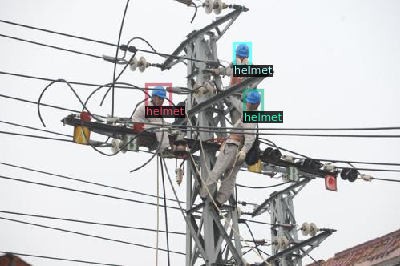

In [19]:
metadata = MetadataCatalog.get(TRAIN_DATA_SET_NAME)
dataset_train = DatasetCatalog.get(TRAIN_DATA_SET_NAME)

dataset_entry = dataset_train[2]
image = cv2.imread(dataset_entry["file_name"])

visualizer = Visualizer(
    image[:, :, ::-1],
    metadata=metadata,
    scale=0.8,
    instance_mode=ColorMode.IMAGE_BW
)

out = visualizer.draw_dataset_dict(dataset_entry)
cv2_imshow(out.get_image()[:, :, ::-1])

# **Entrenamos el modelo**
# Configuracion

In [13]:
# HYPERPARAMETERS
ARCHITECTURE = "faster_rcnn_R_50_FPN_3x"
CONFIG_FILE_PATH = f"COCO-Detection/{ARCHITECTURE}.yaml"
MAX_ITER = 2000
EVAL_PERIOD = 200
BASE_LR = 0.001
NUM_CLASSES = 3

# OUTPUT DIR
OUTPUT_DIR_PATH = os.path.join(
    DATA_SET_NAME,
    ARCHITECTURE,
    datetime.now().strftime('%Y-%m-%d-%H-%M-%S')
)

os.makedirs(OUTPUT_DIR_PATH, exist_ok=True)

In [14]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(CONFIG_FILE_PATH))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(CONFIG_FILE_PATH)
cfg.DATASETS.TRAIN = (TRAIN_DATA_SET_NAME,)
cfg.DATASETS.TEST = (TEST_DATA_SET_NAME,)
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.TEST.EVAL_PERIOD = EVAL_PERIOD
cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = BASE_LR
cfg.SOLVER.MAX_ITER = MAX_ITER
cfg.MODEL.ROI_HEADS.NUM_CLASSES = NUM_CLASSES
cfg.OUTPUT_DIR = OUTPUT_DIR_PATH
cfg.SOLVER.REFERENCE_WORLD_SIZE = 1

In [15]:
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/13 21:45:57 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[12/13 21:45:58 d2.engine.train_loop]: Starting training from iteration 0
[12/13 21:46:16 d2.utils.events]:  eta: 0:27:56  iter: 19  total_loss: 2.02  loss_cls: 1.352  loss_box_reg: 0.4296  loss_rpn_cls: 0.1373  loss_rpn_loc: 0.02407    time: 0.8942  last_time: 1.0972  data_time: 0.0452  last_data_time: 0.0342   lr: 1.9981e-05  max_mem: 8005M
[12/13 21:46:34 d2.utils.events]:  eta: 0:28:57  iter: 39  total_loss: 1.767  loss_cls: 1.125  loss_box_reg: 0.5503  loss_rpn_cls: 0.08949  loss_rpn_loc: 0.02208    time: 0.9068  last_time: 0.7893  data_time: 0.0297  last_data_time: 0.0353   lr: 3.9961e-05  max_mem: 8005M
[12/13 21:46:53 d2.utils.events]:  eta: 0:28:55  iter: 59  total_loss: 1.6  loss_cls: 0.8426  loss_box_reg: 0.7266  loss_rpn_cls: 0.07269  loss_rpn_loc: 0.02656    time: 0.9105  last_time: 0.9475  data_time: 0.0309  last_data_time: 0.0346   lr: 5.9941e-05  max_mem: 8005M
[12/13 21:47:11 d2.utils.events]:  eta: 0:29:05  iter: 79  total_loss: 1.503  loss_cls: 0.6764  loss_box_reg: 

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.


[12/13 21:49:19 d2.utils.events]:  eta: 0:26:58  iter: 219  total_loss: 1.092  loss_cls: 0.3365  loss_box_reg: 0.7319  loss_rpn_cls: 0.01824  loss_rpn_loc: 0.02028    time: 0.9127  last_time: 0.9285  data_time: 0.0338  last_data_time: 0.0625   lr: 0.00021978  max_mem: 8007M
[12/13 21:49:37 d2.utils.events]:  eta: 0:26:40  iter: 239  total_loss: 0.8584  loss_cls: 0.2363  loss_box_reg: 0.6098  loss_rpn_cls: 0.01366  loss_rpn_loc: 0.01508    time: 0.9116  last_time: 0.9631  data_time: 0.0376  last_data_time: 0.0324   lr: 0.00023976  max_mem: 8007M
[12/13 21:49:55 d2.utils.events]:  eta: 0:26:29  iter: 259  total_loss: 0.8121  loss_cls: 0.2074  loss_box_reg: 0.5667  loss_rpn_cls: 0.01545  loss_rpn_loc: 0.01535    time: 0.9119  last_time: 0.9546  data_time: 0.0300  last_data_time: 0.0313   lr: 0.00025974  max_mem: 8007M
[12/13 21:50:15 d2.utils.events]:  eta: 0:26:22  iter: 279  total_loss: 0.7937  loss_cls: 0.2087  loss_box_reg: 0.5356  loss_rpn_cls: 0.01163  loss_rpn_loc: 0.01672    time:

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.


[12/13 21:52:21 d2.utils.events]:  eta: 0:24:07  iter: 419  total_loss: 0.5523  loss_cls: 0.1255  loss_box_reg: 0.3947  loss_rpn_cls: 0.009153  loss_rpn_loc: 0.009897    time: 0.9117  last_time: 0.8558  data_time: 0.0262  last_data_time: 0.0075   lr: 0.00041958  max_mem: 8007M
[12/13 21:52:40 d2.utils.events]:  eta: 0:23:52  iter: 439  total_loss: 0.5355  loss_cls: 0.1292  loss_box_reg: 0.3732  loss_rpn_cls: 0.004531  loss_rpn_loc: 0.01121    time: 0.9121  last_time: 0.8203  data_time: 0.0317  last_data_time: 0.0405   lr: 0.00043956  max_mem: 8007M
[12/13 21:52:58 d2.utils.events]:  eta: 0:23:29  iter: 459  total_loss: 0.5897  loss_cls: 0.1442  loss_box_reg: 0.4018  loss_rpn_cls: 0.007884  loss_rpn_loc: 0.01655    time: 0.9112  last_time: 0.7968  data_time: 0.0277  last_data_time: 0.0099   lr: 0.00045954  max_mem: 8007M
[12/13 21:53:16 d2.utils.events]:  eta: 0:23:10  iter: 479  total_loss: 0.5222  loss_cls: 0.1357  loss_box_reg: 0.3854  loss_rpn_cls: 0.006208  loss_rpn_loc: 0.01066   

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.


[12/13 21:55:24 d2.utils.events]:  eta: 0:21:08  iter: 619  total_loss: 0.4905  loss_cls: 0.1068  loss_box_reg: 0.3468  loss_rpn_cls: 0.009969  loss_rpn_loc: 0.01285    time: 0.9126  last_time: 0.7977  data_time: 0.0332  last_data_time: 0.0053   lr: 0.00061938  max_mem: 8007M
[12/13 21:55:43 d2.utils.events]:  eta: 0:20:49  iter: 639  total_loss: 0.4849  loss_cls: 0.1147  loss_box_reg: 0.3503  loss_rpn_cls: 0.005263  loss_rpn_loc: 0.0101    time: 0.9126  last_time: 1.0155  data_time: 0.0318  last_data_time: 0.0708   lr: 0.00063936  max_mem: 8007M
[12/13 21:56:01 d2.utils.events]:  eta: 0:20:31  iter: 659  total_loss: 0.4714  loss_cls: 0.1145  loss_box_reg: 0.3232  loss_rpn_cls: 0.006093  loss_rpn_loc: 0.01163    time: 0.9120  last_time: 0.9673  data_time: 0.0309  last_data_time: 0.0317   lr: 0.00065934  max_mem: 8007M
[12/13 21:56:19 d2.utils.events]:  eta: 0:20:13  iter: 679  total_loss: 0.4856  loss_cls: 0.09223  loss_box_reg: 0.3624  loss_rpn_cls: 0.003787  loss_rpn_loc: 0.01128    

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.


[12/13 21:58:25 d2.utils.events]:  eta: 0:18:00  iter: 819  total_loss: 0.4722  loss_cls: 0.1212  loss_box_reg: 0.3448  loss_rpn_cls: 0.003981  loss_rpn_loc: 0.008801    time: 0.9102  last_time: 0.8415  data_time: 0.0404  last_data_time: 0.0552   lr: 0.00081918  max_mem: 8007M
[12/13 21:58:44 d2.utils.events]:  eta: 0:17:42  iter: 839  total_loss: 0.4747  loss_cls: 0.1164  loss_box_reg: 0.3466  loss_rpn_cls: 0.003838  loss_rpn_loc: 0.01017    time: 0.9104  last_time: 0.9074  data_time: 0.0327  last_data_time: 0.0229   lr: 0.00083916  max_mem: 8007M
[12/13 21:59:02 d2.utils.events]:  eta: 0:17:24  iter: 859  total_loss: 0.4658  loss_cls: 0.1176  loss_box_reg: 0.3275  loss_rpn_cls: 0.00238  loss_rpn_loc: 0.00985    time: 0.9107  last_time: 0.7485  data_time: 0.0375  last_data_time: 0.0341   lr: 0.00085914  max_mem: 8007M
[12/13 21:59:21 d2.utils.events]:  eta: 0:17:09  iter: 879  total_loss: 0.4733  loss_cls: 0.1191  loss_box_reg: 0.3458  loss_rpn_cls: 0.004765  loss_rpn_loc: 0.01256    

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.


[12/13 22:01:29 d2.utils.events]:  eta: 0:15:02  iter: 1019  total_loss: 0.4666  loss_cls: 0.09778  loss_box_reg: 0.3474  loss_rpn_cls: 0.003486  loss_rpn_loc: 0.01627    time: 0.9118  last_time: 0.9437  data_time: 0.0323  last_data_time: 0.0307   lr: 0.001  max_mem: 8007M
[12/13 22:01:48 d2.utils.events]:  eta: 0:14:44  iter: 1039  total_loss: 0.4955  loss_cls: 0.1125  loss_box_reg: 0.3874  loss_rpn_cls: 0.0045  loss_rpn_loc: 0.01416    time: 0.9125  last_time: 0.9961  data_time: 0.0345  last_data_time: 0.0397   lr: 0.001  max_mem: 8007M
[12/13 22:02:06 d2.utils.events]:  eta: 0:14:26  iter: 1059  total_loss: 0.4949  loss_cls: 0.1109  loss_box_reg: 0.3749  loss_rpn_cls: 0.003586  loss_rpn_loc: 0.01156    time: 0.9124  last_time: 0.9222  data_time: 0.0305  last_data_time: 0.0359   lr: 0.001  max_mem: 8007M
[12/13 22:02:25 d2.utils.events]:  eta: 0:14:07  iter: 1079  total_loss: 0.5143  loss_cls: 0.1402  loss_box_reg: 0.3572  loss_rpn_cls: 0.004705  loss_rpn_loc: 0.01435    time: 0.9124

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.


[12/13 22:04:34 d2.utils.events]:  eta: 0:12:01  iter: 1219  total_loss: 0.4963  loss_cls: 0.1294  loss_box_reg: 0.3544  loss_rpn_cls: 0.005138  loss_rpn_loc: 0.01053    time: 0.9135  last_time: 0.9427  data_time: 0.0372  last_data_time: 0.0248   lr: 0.001  max_mem: 8007M
[12/13 22:04:52 d2.utils.events]:  eta: 0:11:43  iter: 1239  total_loss: 0.5194  loss_cls: 0.1217  loss_box_reg: 0.3605  loss_rpn_cls: 0.004286  loss_rpn_loc: 0.01166    time: 0.9136  last_time: 0.9508  data_time: 0.0293  last_data_time: 0.0263   lr: 0.001  max_mem: 8007M
[12/13 22:05:10 d2.utils.events]:  eta: 0:11:24  iter: 1259  total_loss: 0.502  loss_cls: 0.1192  loss_box_reg: 0.3546  loss_rpn_cls: 0.004425  loss_rpn_loc: 0.01313    time: 0.9135  last_time: 0.8535  data_time: 0.0362  last_data_time: 0.0200   lr: 0.001  max_mem: 8007M
[12/13 22:05:29 d2.utils.events]:  eta: 0:11:05  iter: 1279  total_loss: 0.4602  loss_cls: 0.1189  loss_box_reg: 0.3259  loss_rpn_cls: 0.005517  loss_rpn_loc: 0.01369    time: 0.9140

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.


[12/13 22:07:37 d2.utils.events]:  eta: 0:08:56  iter: 1419  total_loss: 0.4532  loss_cls: 0.105  loss_box_reg: 0.3419  loss_rpn_cls: 0.002697  loss_rpn_loc: 0.01138    time: 0.9137  last_time: 0.9421  data_time: 0.0290  last_data_time: 0.0655   lr: 0.001  max_mem: 8007M
[12/13 22:07:55 d2.utils.events]:  eta: 0:08:36  iter: 1439  total_loss: 0.4622  loss_cls: 0.1152  loss_box_reg: 0.3291  loss_rpn_cls: 0.001733  loss_rpn_loc: 0.01097    time: 0.9137  last_time: 0.9744  data_time: 0.0333  last_data_time: 0.0331   lr: 0.001  max_mem: 8007M
[12/13 22:08:13 d2.utils.events]:  eta: 0:08:19  iter: 1459  total_loss: 0.418  loss_cls: 0.08792  loss_box_reg: 0.3112  loss_rpn_cls: 0.003059  loss_rpn_loc: 0.012    time: 0.9137  last_time: 0.9361  data_time: 0.0273  last_data_time: 0.0188   lr: 0.001  max_mem: 8007M
[12/13 22:08:32 d2.utils.events]:  eta: 0:08:00  iter: 1479  total_loss: 0.4464  loss_cls: 0.1121  loss_box_reg: 0.3179  loss_rpn_cls: 0.003356  loss_rpn_loc: 0.01287    time: 0.9138  

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.


[12/13 22:10:41 d2.utils.events]:  eta: 0:05:51  iter: 1619  total_loss: 0.4715  loss_cls: 0.1092  loss_box_reg: 0.3192  loss_rpn_cls: 0.002981  loss_rpn_loc: 0.01194    time: 0.9141  last_time: 1.0601  data_time: 0.0311  last_data_time: 0.0390   lr: 0.001  max_mem: 8007M
[12/13 22:10:59 d2.utils.events]:  eta: 0:05:32  iter: 1639  total_loss: 0.4949  loss_cls: 0.1152  loss_box_reg: 0.3547  loss_rpn_cls: 0.004206  loss_rpn_loc: 0.01299    time: 0.9137  last_time: 0.8147  data_time: 0.0340  last_data_time: 0.0288   lr: 0.001  max_mem: 8007M
[12/13 22:11:16 d2.utils.events]:  eta: 0:05:13  iter: 1659  total_loss: 0.5297  loss_cls: 0.1255  loss_box_reg: 0.3787  loss_rpn_cls: 0.002916  loss_rpn_loc: 0.0137    time: 0.9135  last_time: 0.9432  data_time: 0.0291  last_data_time: 0.0235   lr: 0.001  max_mem: 8007M
[12/13 22:11:35 d2.utils.events]:  eta: 0:04:55  iter: 1679  total_loss: 0.4425  loss_cls: 0.1015  loss_box_reg: 0.3187  loss_rpn_cls: 0.004085  loss_rpn_loc: 0.0125    time: 0.9136 

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.


[12/13 22:13:45 d2.utils.events]:  eta: 0:02:46  iter: 1819  total_loss: 0.4605  loss_cls: 0.08675  loss_box_reg: 0.3541  loss_rpn_cls: 0.002648  loss_rpn_loc: 0.009955    time: 0.9145  last_time: 0.9680  data_time: 0.0278  last_data_time: 0.0294   lr: 0.001  max_mem: 8007M
[12/13 22:14:03 d2.utils.events]:  eta: 0:02:28  iter: 1839  total_loss: 0.4481  loss_cls: 0.107  loss_box_reg: 0.3236  loss_rpn_cls: 0.002548  loss_rpn_loc: 0.01421    time: 0.9145  last_time: 0.9989  data_time: 0.0414  last_data_time: 0.0308   lr: 0.001  max_mem: 8007M
[12/13 22:14:21 d2.utils.events]:  eta: 0:02:09  iter: 1859  total_loss: 0.462  loss_cls: 0.1227  loss_box_reg: 0.335  loss_rpn_cls: 0.00299  loss_rpn_loc: 0.01069    time: 0.9145  last_time: 0.9029  data_time: 0.0294  last_data_time: 0.0374   lr: 0.001  max_mem: 8007M
[12/13 22:14:40 d2.utils.events]:  eta: 0:01:51  iter: 1879  total_loss: 0.4135  loss_cls: 0.1111  loss_box_reg: 0.3072  loss_rpn_cls: 0.001752  loss_rpn_loc: 0.008934    time: 0.9146

This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.


In [16]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir $OUTPUT_DIR_PATH

<IPython.core.display.Javascript object>

### Evaluation

In [17]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg)

[12/13 22:16:41 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from Hard-Hat-Workers-10/faster_rcnn_R_50_FPN_3x/2023-12-13-21-45-51/model_final.pth ...


WARNING [12/13 22:17:35 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/13 22:17:35 d2.data.datasets.coco]: Loaded 1413 images in COCO format from /content/Hard-Hat-Workers-10/valid/_annotations.coco.json


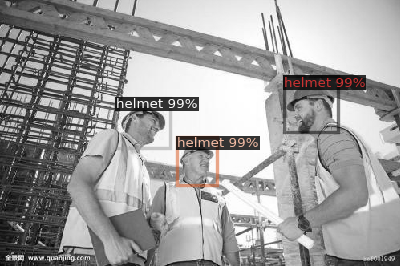

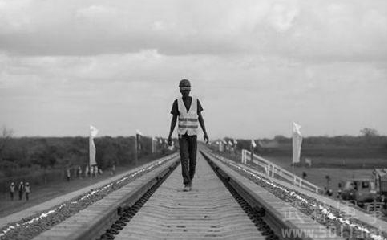

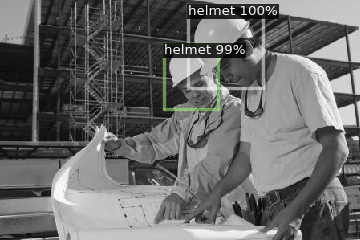

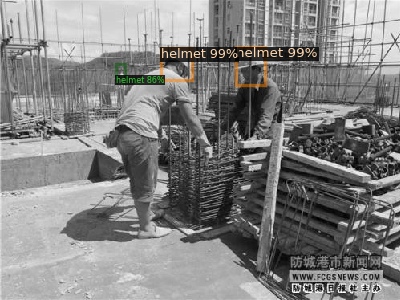

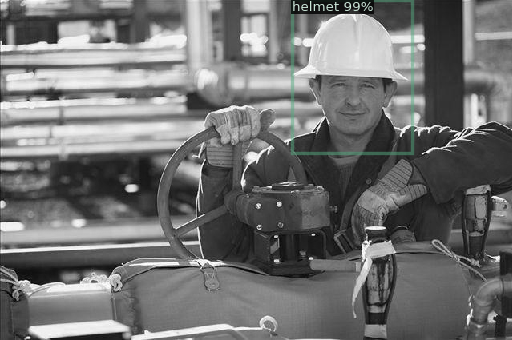

...

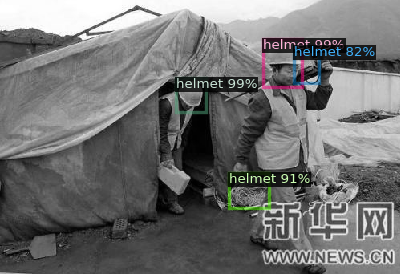

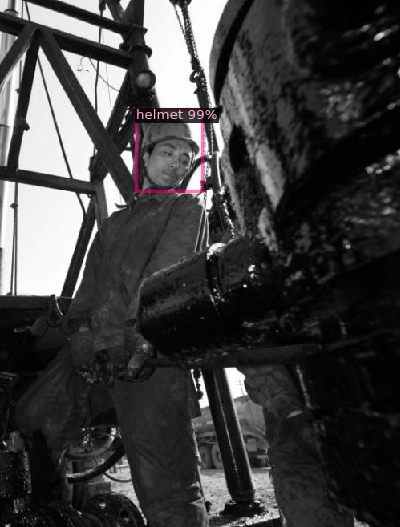

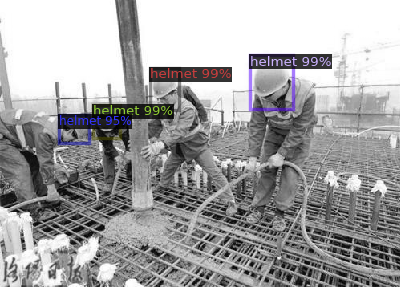

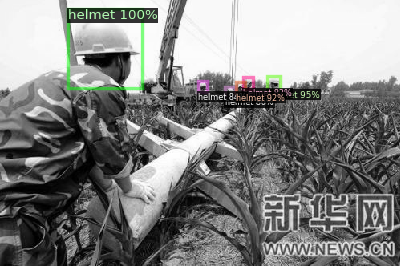

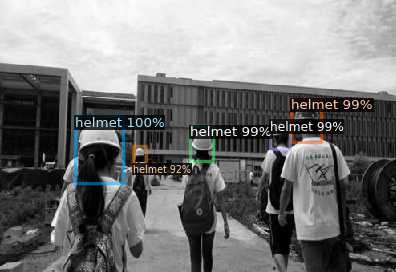

In [ ]:
dataset_valid = DatasetCatalog.get(VALID_DATA_SET_NAME)

for d in dataset_valid:
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    visualizer = Visualizer(
        img[:, :, ::-1],
        metadata=metadata,
        scale=0.8,
        instance_mode=ColorMode.IMAGE_BW
    )
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

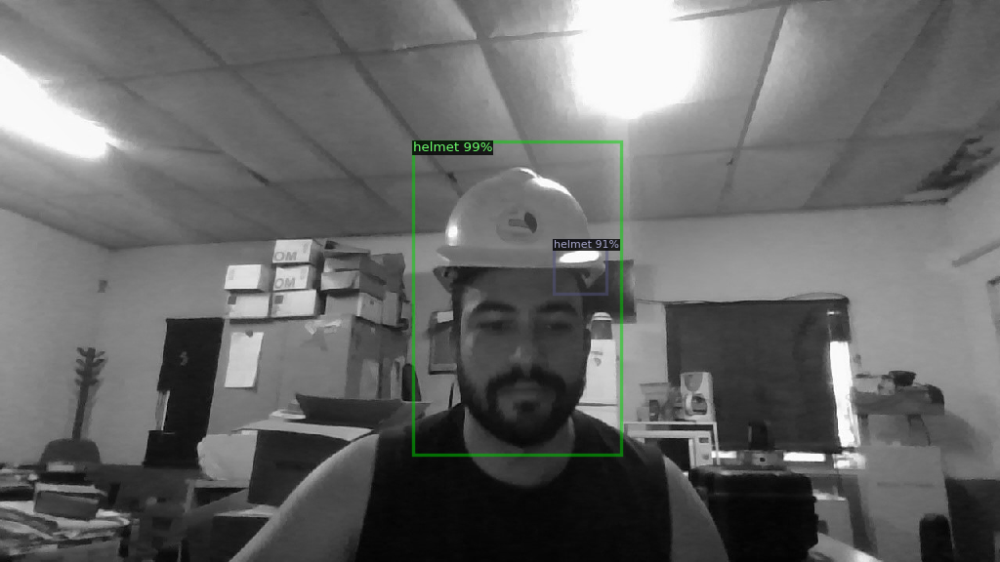

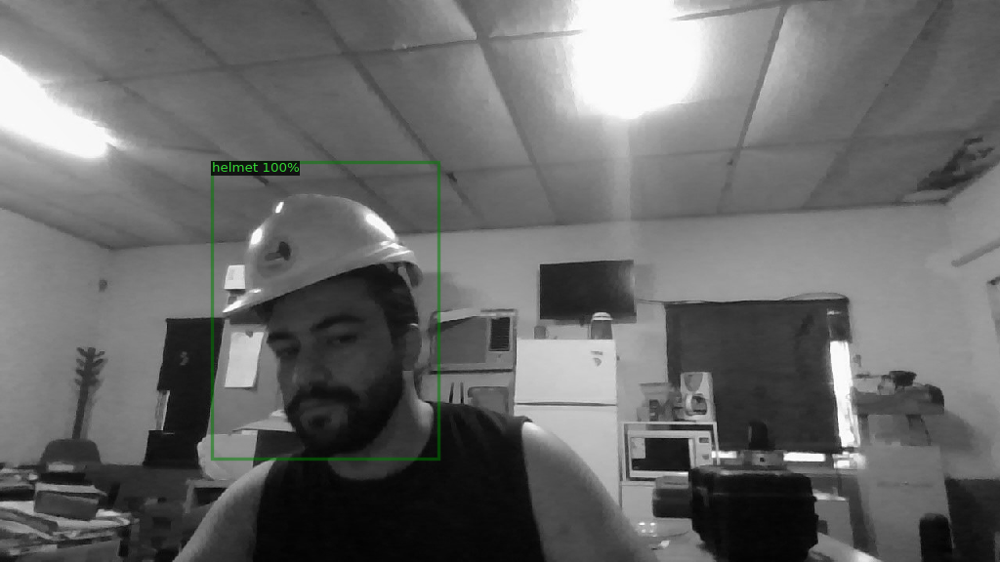

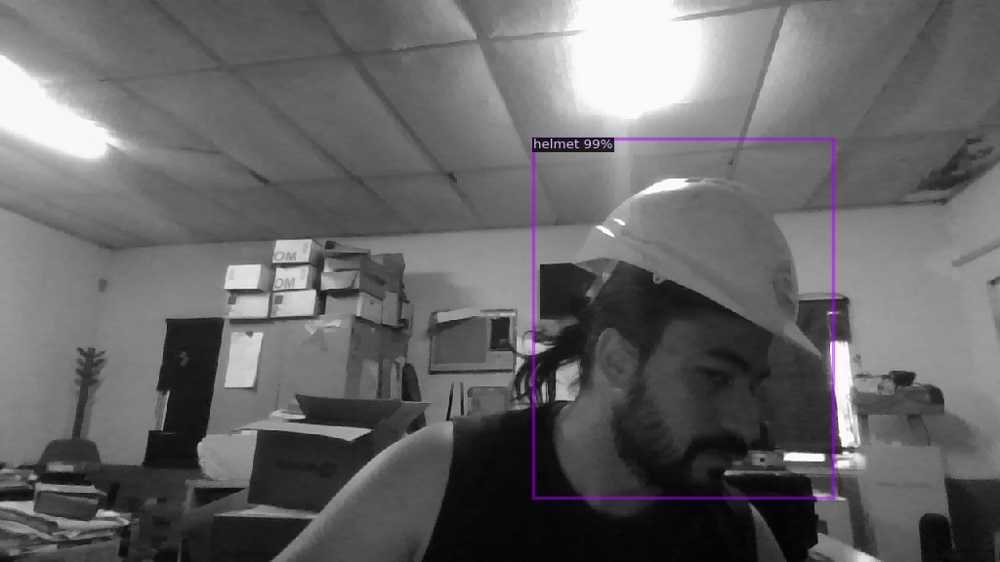

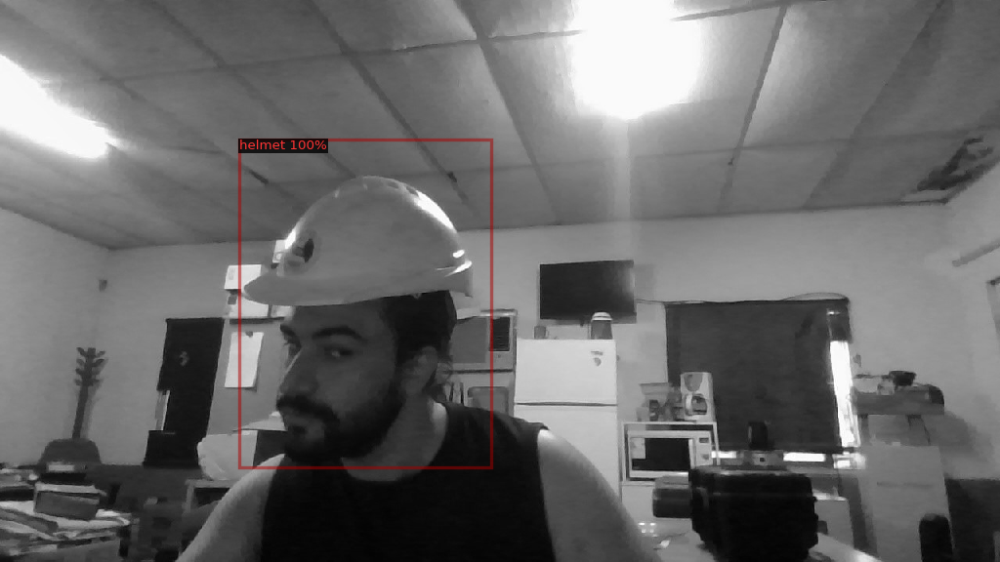

In [21]:
import os

# Specify the path to the folder containing the new pictures
folder_path = "/content/fotos"

# Iterate over each file in the folder
for filename in os.listdir(folder_path):
    if filename.endswith(('.jpg', '.jpeg', '.png')):  # Check if the file is an image
        # Construct the full path to the image file
        img_path = os.path.join(folder_path, filename)

        # Read the image
        img = cv2.imread(img_path)

        # Perform object detection
        outputs = predictor(img)

        # Create a visualizer
        visualizer = Visualizer(
            img[:, :, ::-1],
            metadata=metadata,
            scale=0.8,
            instance_mode=ColorMode.IMAGE_BW
        )

        # Draw instance predictions on the image
        out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))

        # Display the result
        cv2_imshow(out.get_image()[:, :, ::-1])